En este documento podrás encontrar como se procesan señales para analisis de sentimientos en base a imágenes.
para esto utilizaremos algunas librerias de python.

In [ ]:
!pip install face_recognition
!pip install opencv-contrib-python
!pip install matplotlib
!pip install deepface
!pip install FER
!pip install tensorflow-gpu

Luego de importar las librerias repasamos algunos ejemplos mostrados en clase.

en este ejemplo se detectan las facciones faciales importantes para la detección de sentimientos y la ubicación dentro de la imágen.
estos elementos son:
barbilla, ceja izquierda, ceja derecha, puente de nariz, punta de nariz, ojo izquierdo, ojo derecho, labio superior y labio inferior

The chin in this face has the following points: [(414, 860), (412, 951), (422, 1041), (459, 1131), (513, 1213), (583, 1286), (658, 1344), (733, 1405), (828, 1421), (920, 1403), (999, 1350), (1076, 1290), (1142, 1220), (1182, 1131), (1197, 1030), (1207, 923), (1210, 817)]
The left_eyebrow in this face has the following points: [(497, 733), (541, 696), (602, 684), (662, 691), (721, 715)]
The right_eyebrow in this face has the following points: [(847, 708), (914, 672), (989, 657), (1060, 671), (1118, 709)]
The nose_bridge in this face has the following points: [(782, 801), (778, 868), (774, 934), (772, 1001)]
The nose_tip in this face has the following points: [(704, 1055), (746, 1063), (791, 1070), (838, 1052), (887, 1039)]
The left_eye in this face has the following points: [(559, 828), (599, 802), (647, 801), (684, 829), (644, 841), (597, 841)]
The right_eye in this face has the following points: [(901, 817), (942, 778), (992, 777), (1037, 800), (997, 820), (945, 826)]
The top_lip in t

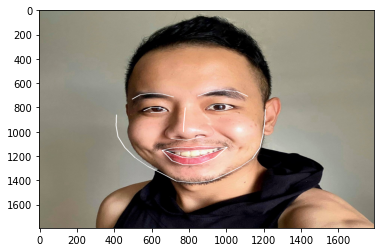

In [ ]:
import numpy as np
import pandas as pd
import cv2 as cv 
##from google.colab.patches import cv2_imshow # for image display
#from skimage import io
from PIL import Image, ImageDraw
import matplotlib.pylab as plt
import face_recognition
import urllib.request

urls = ["https://carlofontanos.com/wp-content/themes/carlo-fontanos/img/carlofontanos.jpg",
       "https://iiif.lib.ncsu.edu/iiif/0016007/full/800,/0/default.jpg"]  
# Read and display the image
# loop over the image URLs, you could store several image urls in the list

for url in urls:
  #imagen = io.imread(url) 
  #image_2 = cv.cvtColor(image, cv.COLOR_BGR2RGB)
  #final_frame = cv.hconcat((image, image_2))
  #cv2_imshow(final_frame)
  img = urllib.request.urlopen(url)
  image = face_recognition.load_image_file(img)
  face_landmarks_list = face_recognition.face_landmarks(image)
  pil_image = Image.fromarray(image)
  d = ImageDraw.Draw(pil_image)

  for face_landmarks in face_landmarks_list:

    # Print the location of each facial feature in this image
    for facial_feature in face_landmarks.keys():
        print("The {} in this face has the following points: {}".format(facial_feature, face_landmarks[facial_feature]))

    # Let's trace out each facial feature in the image with a line!
    for facial_feature in face_landmarks.keys():
        d.line(face_landmarks[facial_feature], width=5)

        # Show the picture
    plt.imshow(pil_image, aspect='auto')  
  

  print('\n')

En el siguiente ejemplo se utiliza la libreria face_recognition para mostrar el reconocimiento de facciones específicas en base a un ejemplo (imagen conocida) entregado previamente 

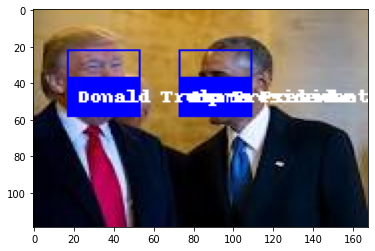

In [ ]:
from PIL import Image, ImageDraw
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
import face_recognition

Path = "Video/Images/"
def draw_rec(url1, url2, url3):
  # This is an example of running face recognition on a single image
  # and drawing a box around each person that was identified.

  # Load a sample picture and learn how to recognize it.
  obama_image = face_recognition.load_image_file(url1)
  obama_face_encoding = face_recognition.face_encodings(obama_image)[0]

  # Load a second sample picture and learn how to recognize it.
  biden_image = face_recognition.load_image_file(url2)
  biden_face_encoding = face_recognition.face_encodings(biden_image)[0]

  # Create arrays of known face encodings and their names
  known_face_encodings = [
      obama_face_encoding,
      biden_face_encoding
  ]
  known_face_names = [
      "Obama Presidente",
      "Donald Trump Presidente"
  ]

  # Load an image with an unknown face
  unknown_image = face_recognition.load_image_file(url3)

  # Find all the faces and face encodings in the unknown image
  face_locations = face_recognition.face_locations(unknown_image)
  face_encodings = face_recognition.face_encodings(unknown_image, face_locations)

  # Convert the image to a PIL-format image so that we can draw on top of it with the Pillow library
  # See http://pillow.readthedocs.io/ for more about PIL/Pillow
  pil_image = Image.fromarray(unknown_image)
  # Create a Pillow ImageDraw Draw instance to draw with
  draw = ImageDraw.Draw(pil_image)

  # Loop through each face found in the unknown image
  for (top, right, bottom, left), face_encoding in zip(face_locations, face_encodings):
      # See if the face is a match for the known face(s)
      matches = face_recognition.compare_faces(known_face_encodings, face_encoding)

      name = "Unknown"

      # If a match was found in known_face_encodings, just use the first one.
      if True in matches:
          first_match_index = matches.index(True)
          name = known_face_names[first_match_index]

      # Draw a box around the face using the Pillow module
      draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

      # Draw a label with a name below the face
      text_width, text_height = draw.textsize(name)
      draw.rectangle(((left, bottom - text_height - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
      draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))


  # Remove the drawing library from memory as per the Pillow docs
  del draw

  # Display the resulting image
  plt.imshow(pil_image, aspect='auto')

  # You can also save a copy of the new image to disk if you want by uncommenting this line
  # pil_image.save("image_with_boxes.jpg")
draw_rec(Path + "Known/obama.jpeg", Path + "Known/trump.jpg", Path + "Unknown/obama_trump.jpeg")

en este ejemplo se muestra como extraer fotogramas y almacenar un video utilizando librerias de python, en particular open cv

In [ ]:
import cv2
import datetime
# top of the file
import os
import errno

base_path = "Video/"
# the actual code
path = base_path + datetime.datetime.now().strftime('%Y%m%d%H%M%S%f') + "/"
filename = "frame"
lastPathUsed = path
try:
    os.makedirs(path)
    os.makedirs(path + "analyzed/")
except OSError as exc: 
    if exc.errno == errno.EEXIST and os.path.isdir(directory_name):
        pass

fourcc = cv2.VideoWriter_fourcc(*'mp4v')

cap = cv2.VideoCapture(0)
out = cv2.VideoWriter(path +'output.mp4', fourcc, 20.0, (640,480))
if (cap.isOpened()== False):
  print("Error opening video stream or file")

count = 0
while(cap.isOpened()):
  count += 1
  ret, frame = cap.read()
  if ret == True:
    out.write(frame)
    cv2.imwrite(path + filename + str(count) + ".jpeg", frame)
    cv2.imshow('Preview',frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
      break
  # Break the loop
  else:
    break
# When everything done, release the video capture object      
cap.release()
# Closes all the frames
out.release()
cv2.waitKey(0)
cv2.destroyAllWindows()

In [ ]:
lastPathUsed

'Video/20220423100404304067/'

esta es una función que se utilizará mas adelante para desplegar un gráfico con la intensidad de las emociones detectadas

In [ ]:
import json
def draw_bar_graph(emotions):
  dictionary = emotions
  xAxis = [key for key, value in dictionary.items()]
  yAxis = [value for key, value in dictionary.items()]
  plt.grid(True)

  ## BAR GRAPH ##
  
  fig = plt.figure()
  plt.bar(xAxis,yAxis, color='maroon')
  plt.xlabel('Emotion')
  plt.ylabel('intensity')

  plt.show()

En el siguiente bloque se encuentra un ejemplo de detección de emociones del video, esta tecnica se utiliza para analizar videos que ya están almacenados de antemano y se puede analizar en cada fotograma generado las emociones.

Video/20220423100404304067/output.mp4
Video/20220423100404304067/analyzed/
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new frame:  True
Read a new fr

Action: race: 100%|███████████████████████████████| 4/4 [00:01<00:00,  3.68it/s]


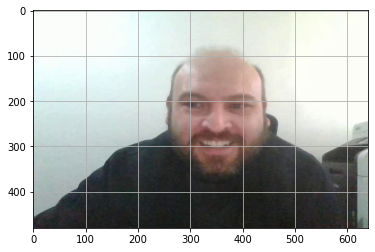

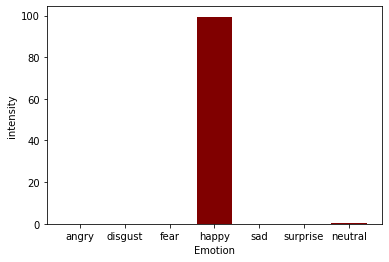

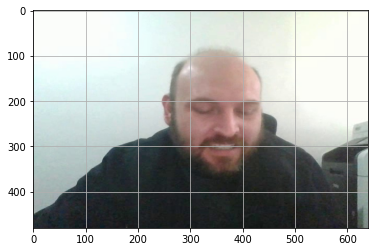

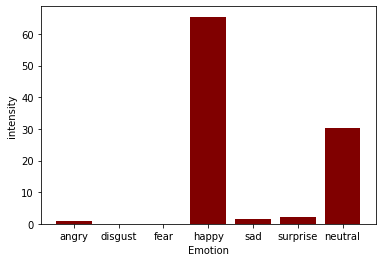

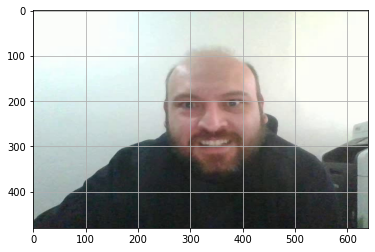

...

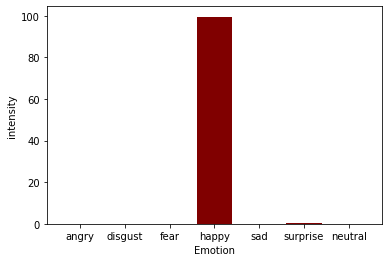

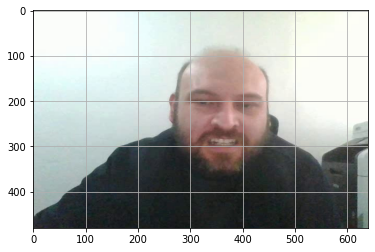

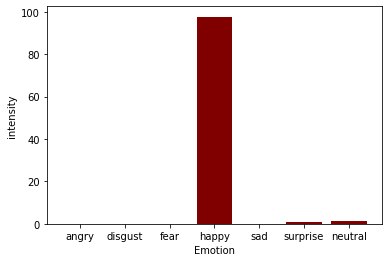

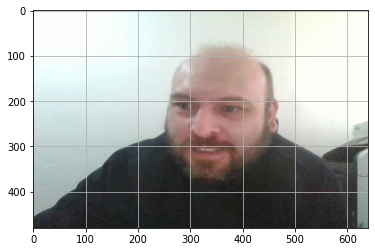

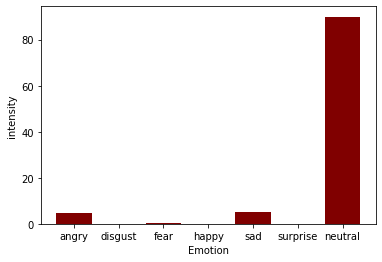

In [ ]:
import cv2
import os
from deepface import DeepFace
from PIL import Image, ImageDraw
from matplotlib import pyplot as plt
import matplotlib.image as mpimg
models = ["VGG-Face", "Facenet", "Facenet512", "OpenFace", "DeepFace", "DeepID", "ArcFace", "Dlib"]
 
def extractImages(pathIn, pathOut):
    count = 0
    vidcap = cv2.VideoCapture(pathIn)
    success,image = vidcap.read()
    success = True
    print (pathIn)
    print (pathOut)

    while success:
        vidcap.set(cv2.CAP_PROP_POS_MSEC,(count*100))    # added this line 
        success,image = vidcap.read()
        print ('Read a new frame: ', success)
        if not success:
          break
        cv2.imwrite( pathOut + "frame%d.jpg" % count, image)     # save frame as JPEG file
        count = count + 1

extractImages(lastPathUsed +"output.mp4", lastPathUsed +"analyzed/")

backends = ['opencv', 'ssd', 'dlib', 'mtcnn', 'retinaface']


# assign directory
directory = lastPathUsed + "analyzed/"

# iterate over files in
# that directory
result = []

for filename in os.listdir(directory):
  f = os.path.join(directory, filename)
  # checking if it is a file
  if os.path.isfile(f):
    demography = DeepFace.analyze(f, detector_backend = backends[0],enforce_detection=False)
    #demography = DeepFace.analyze("images/video/20220403115958295120/analyzed/frame1.jpg")
    #print (demography)
    pil_image = Image.open(f)
    result.append((pil_image,demography))
		

for img, demo in result:
    plt.imshow(img, aspect='auto')
    draw_bar_graph(demo['emotion'])

en el siguiente ejemplo se puede ver reconocimiento facial en vivo, al igual que anteriormente se hizo con una imagen en particular, pero ahora en un video live

In [ ]:
import face_recognition
import cv2
import numpy as np 
base_path = "Video/Images/Known/"
video_captura=cv2.VideoCapture(0)

#carga imagenes para aprender a reconocer eso

obama_image = face_recognition.load_image_file(base_path + "obama.jpeg")
obama_face_encoding = face_recognition.face_encodings(obama_image)[0]

biden_image = face_recognition.load_image_file(base_path + "biden.jpeg")
biden_face_encoding = face_recognition.face_encodings(biden_image)[0]

rlabbe_image = face_recognition.load_image_file(base_path + "rlabbe.jpeg")
rlabbe_face_encoding = face_recognition.face_encodings(rlabbe_image)[0]

# Create arrays of known face encodings and their names
known_face_encodings = [
    obama_face_encoding,
    biden_face_encoding,
    rlabbe_face_encoding
]
known_face_names = [
    "Barack Obama",
    "Joe Biden",
    "Ramon Labbe"
]

# Initialize some variables
face_locations = []
face_encodings = []
face_names = []
process_this_frame = True

while True:
    # Grab a single frame of video
    ret, frame = video_captura.read()

    # Resize frame of video to 1/4 size for faster face recognition processing
    small_frame = cv2.resize(frame, (0, 0), fx=0.25, fy=0.25)

    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    rgb_small_frame = small_frame[:, :, ::-1]

    # Only process every other frame of video to save time
    if process_this_frame:
        # Find all the faces and face encodings in the current frame of video
        face_locations = face_recognition.face_locations(rgb_small_frame)
        face_encodings = face_recognition.face_encodings(rgb_small_frame, face_locations)

        face_names = []
        for face_encoding in face_encodings:
            # See if the face is a match for the known face(s)
            matches = face_recognition.compare_faces(known_face_encodings, face_encoding)
            name = "Unknown"

            # # If a match was found in known_face_encodings, just use the first one.
            # if True in matches:
            #     first_match_index = matches.index(True)
            #     name = known_face_names[first_match_index]

            # Or instead, use the known face with the smallest distance to the new face
            face_distances = face_recognition.face_distance(known_face_encodings, face_encoding)
            best_match_index = np.argmin(face_distances)
            if matches[best_match_index]:
                name = known_face_names[best_match_index]

            face_names.append(name)

    process_this_frame = not process_this_frame


    # Display the results
    for (top, right, bottom, left), name in zip(face_locations, face_names):
        # Scale back up face locations since the frame we detected in was scaled to 1/4 size
        top *= 4
        right *= 4
        bottom *= 4
        left *= 4

        # Draw a box around the face
        cv2.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), 2)

        # Draw a label with a name below the face
        cv2.rectangle(frame, (left, bottom - 35), (right, bottom), (0, 0, 255), cv2.FILLED)
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, name, (left + 6, bottom - 6), font, 1.0, (255, 255, 255), 1)

    # Display the resulting image
    cv2.imshow('Video', frame)

    # Hit 'q' on the keyboard to quit!
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release handle to the webcam
video_captura.release()
cv2.destroyAllWindows

<function destroyAllWindows>

en el siguiente ejemplo se utiliza la libreria FER para hacer encuadre y recomposición en el video tomando un video guardado como input y botando como resultado un video pero con un cuadro y la intensidad de las emociones en otro video.

INFO:fer:20.00 fps, 365 frames, 18.25 seconds
INFO:fer:Making directories at output
INFO:fer:Deleted pre-existing output/output_output.mp4
100%|█████████████████████████████████████| 365/365 [04:57<00:00,  1.23frames/s]
INFO:fer:Completed analysis: saved to output/output_output.mp4
INFO:fer:Starting to Zip
INFO:fer:Compressing: 13%
INFO:fer:Compressing: 27%
INFO:fer:Compressing: 41%
INFO:fer:Compressing: 54%
INFO:fer:Compressing: 68%
INFO:fer:Compressing: 82%
INFO:fer:Compressing: 95%
INFO:fer:Zip has finished


,Human Emotions,Emotion Value from the Video
0,Angry,9.57
1,Disgust,0.00
2,Fear,17.16
3,Happy,173.02
4,Sad,24.79
5,Surprise,2.05
6,Neutral,137.77


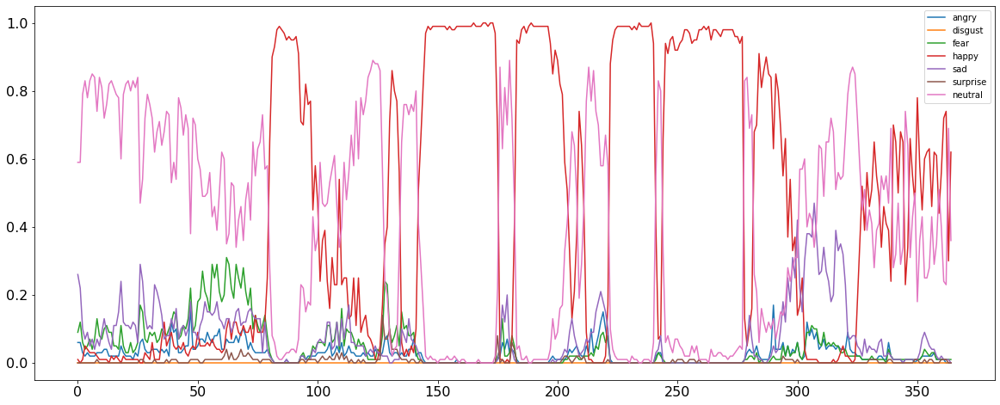

In [ ]:
from fer import Video
from fer import FER
import os
import sys
import pandas as pd

# Put in the location of the video file that has to be processed
location_videofile = lastPathUsed + "output.mp4"

# Build the Face detection detector
face_detector = FER(mtcnn=True)
# Input the video for processing
input_video = Video(location_videofile)

# The Analyze() function will run analysis on every frame of the input video. 
# It will create a rectangular box around every image and show the emotion values next to that.
# Finally, the method will publish a new video that will have a box around the face of the human with live emotion values.
processing_data = input_video.analyze(face_detector, display=False)

# We will now convert the analysed information into a dataframe.
# This will help us import the data as a .CSV file to perform analysis over it later
vid_df = input_video.to_pandas(processing_data)
vid_df = input_video.get_first_face(vid_df)
vid_df = input_video.get_emotions(vid_df)

# Plotting the emotions against time in the video
pltfig = vid_df.plot(figsize=(20, 8), fontsize=16).get_figure()

# We will now work on the dataframe to extract which emotion was prominent in the video
angry = sum(vid_df.angry)
disgust = sum(vid_df.disgust)
fear = sum(vid_df.fear)
happy = sum(vid_df.happy)
sad = sum(vid_df.sad)
surprise = sum(vid_df.surprise)
neutral = sum(vid_df.neutral)

emotions = ['Angry', 'Disgust', 'Fear', 'Happy', 'Sad', 'Surprise', 'Neutral']
emotions_values = [angry, disgust, fear, happy, sad, surprise, neutral]

score_comparisons = pd.DataFrame(emotions, columns = ['Human Emotions'])
score_comparisons['Emotion Value from the Video'] = emotions_values
score_comparisons

esto es solo para verificar que la tarjeta gráfica está habilitada y el procesamiento utilizará cuda o cpu para procesar.

In [2]:
import os
import torch
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Using {} device'.format(device))

Using cuda device


en el siguiente ejemplo se hace la creación y entrenamiento y validacion de un modelo en base a un dataset descargado de internet

In [2]:
#importing important libraries
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import os

# Importing Deep Learning Libraries

from keras.preprocessing.image import load_img, img_to_array
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense,Input,Dropout,GlobalAveragePooling2D,Flatten,Conv2D,BatchNormalization,Activation,MaxPooling2D
from keras.models import Model,Sequential
from tensorflow.keras.optimizers import Adam,SGD,RMSprop

In [3]:
#taking inputs images for training
picture_size = 48
folder_path = "Video/Dataset/images/"

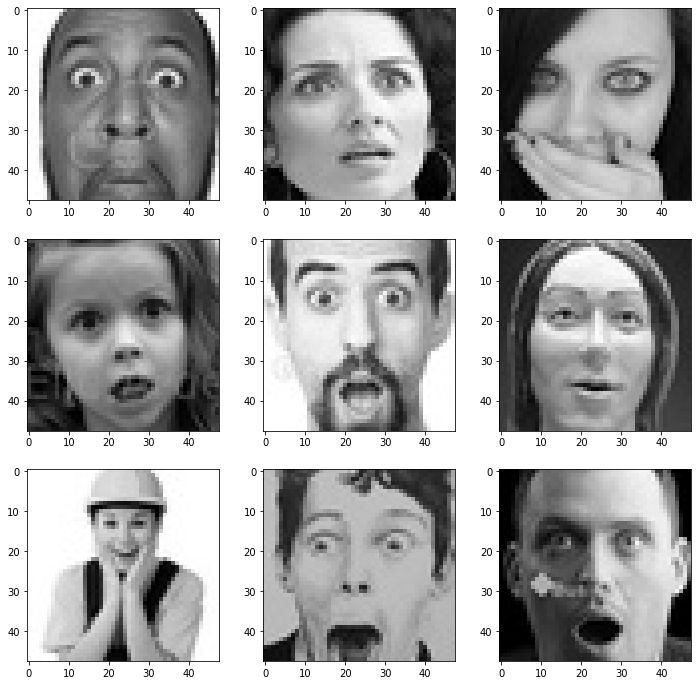

In [4]:
expression = 'surprise'

plt.figure(figsize= (12,12))
for i in range(1, 10, 1):
    plt.subplot(3,3,i)
    img = load_img(folder_path+"train/"+expression+"/"+
                  os.listdir(folder_path + "train/" + expression)[i], target_size=(picture_size, picture_size))
    plt.imshow(img)   
plt.show()

In [5]:
batch_size  = 128

datagen_train  = ImageDataGenerator()
datagen_val = ImageDataGenerator()

train_set = datagen_train.flow_from_directory(folder_path+"train",
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical',
                                              shuffle=True)


test_set = datagen_val.flow_from_directory(folder_path+"validation",
                                              target_size = (picture_size,picture_size),
                                              color_mode = "grayscale",
                                              batch_size=batch_size,
                                              class_mode='categorical',
                                              shuffle=False)

Found 28821 images belonging to 7 classes.
Found 7066 images belonging to 7 classes.


In [7]:
from tensorflow.keras.optimizers import Adam,SGD,RMSprop


no_of_classes = 7

model = Sequential()

#1st CNN layer
model.add(Conv2D(64,(3,3),padding = 'same',input_shape = (48,48,1)))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout(0.25))

#2nd CNN layer
model.add(Conv2D(128,(5,5),padding = 'same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout (0.25))

#3rd CNN layer
model.add(Conv2D(512,(3,3),padding = 'same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size = (2,2)))
model.add(Dropout (0.25))

#4th CNN layer
model.add(Conv2D(512,(3,3), padding='same'))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Dropout(0.25))

model.add(Flatten())

#Fully connected 1st layer
model.add(Dense(256))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))


# Fully connected layer 2nd layer
model.add(Dense(512))
model.add(BatchNormalization())
model.add(Activation('relu'))
model.add(Dropout(0.25))

model.add(Dense(no_of_classes, activation='softmax'))



opt = Adam(learning_rate = 0.0001)
model.compile(optimizer=opt,loss='categorical_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_4 (Conv2D)           (None, 48, 48, 64)        640       
                                                                 
 batch_normalization_6 (Batc  (None, 48, 48, 64)       256       
 hNormalization)                                                 
                                                                 
 activation_6 (Activation)   (None, 48, 48, 64)        0         
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 24, 24, 64)       0         
 2D)                                                             
                                                                 
 dropout_6 (Dropout)         (None, 24, 24, 64)        0         
                                                                 
 conv2d_5 (Conv2D)           (None, 24, 24, 128)      

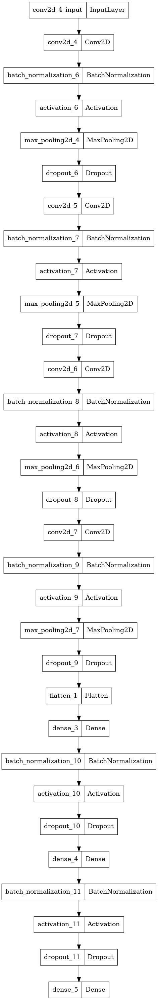

In [8]:
#visualizing the model
import tensorflow as tf
tf.keras.utils.plot_model(
    model,
    to_file="model.png",
    show_shapes=False,
    show_dtype=False,
    show_layer_names=True,
    rankdir="TB",
    expand_nested=False,
    dpi=96,
    layer_range=None,
)

In [9]:
#importing tensorflow library and package
from tensorflow.keras.optimizers import RMSprop,SGD,Adam
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau

checkpoint = ModelCheckpoint("./model.h5", monitor='val_accuracy', verbose=1, save_best_only=True, mode='max')
#Stopping training when a monitored metric has stopped improving.
early_stopping = EarlyStopping(monitor='val_loss',
                          min_delta=0,
                          patience=3,
                          verbose=1,
                          restore_best_weights=True
                          )

reduce_learningrate = ReduceLROnPlateau(monitor='val_loss',
                              factor=0.2,
                              patience=3,
                              verbose=1,
                              min_delta=0.0001)

callbacks_list = [early_stopping,checkpoint,reduce_learningrate]

epochs = 50

model.compile(loss='categorical_crossentropy',
              optimizer = Adam(learning_rate=0.001),
              metrics=['accuracy'])

In [10]:
#fitting model with 48 epoch
history = model.fit_generator(generator=train_set,
                                steps_per_epoch=train_set.n//train_set.batch_size,
                                epochs=epochs,
                                validation_data = test_set,
                                validation_steps = test_set.n//test_set.batch_size,
                                callbacks=callbacks_list
                                )

Epoch 1/50


/tmp/ipykernel_5105/2587516832.py:2: UserWarning: `Model.fit_generator` is deprecated and will be removed in a future version. Please use `Model.fit`, which supports generators.
  history = model.fit_generator(generator=train_set,


225/225 [==============================] - ETA: 0s - loss: 1.7609 - accuracy: 0.3228
Epoch 1: val_accuracy improved from -inf to 0.39616, saving model to ./model.h5
225/225 [==============================] - 269s 1s/step - loss: 1.7609 - accuracy: 0.3228 - val_loss: 1.6184 - val_accuracy: 0.3962 - lr: 0.0010
Epoch 2/50
225/225 [==============================] - ETA: 0s - loss: 1.4180 - accuracy: 0.4536
Epoch 2: val_accuracy improved from 0.39616 to 0.40114, saving model to ./model.h5
225/225 [==============================] - 271s 1s/step - loss: 1.4180 - accuracy: 0.4536 - val_loss: 1.6297 - val_accuracy: 0.4011 - lr: 0.0010
Epoch 3/50
225/225 [==============================] - ETA: 0s - loss: 1.2680 - accuracy: 0.5130
Epoch 3: val_accuracy improved from 0.40114 to 0.50057, saving model to ./model.h5
225/225 [==============================] - 273s 1s/step - loss: 1.2680 - accuracy: 0.5130 - val_loss: 1.3100 - val_accuracy: 0.5006 - lr: 0.0010
Epoch 4/50
225/225 [======================

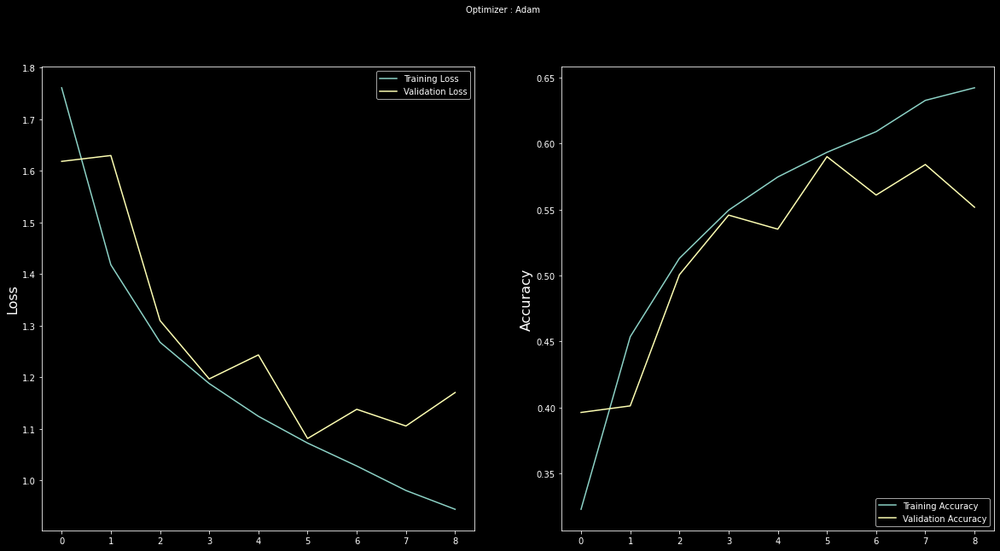

In [11]:
#plotting graph to check accuracy and loss
plt.style.use('dark_background')

plt.figure(figsize=(20,10))
plt.subplot(1, 2, 1)
plt.suptitle('Optimizer : Adam', fontsize=10)
plt.ylabel('Loss', fontsize=16)
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend(loc='upper right')

plt.subplot(1, 2, 2)
plt.ylabel('Accuracy', fontsize=16)
plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.legend(loc='lower right')
plt.show()

en el siguiente bloque comprobamos algunas de las imagenes utilizada para el entrenamiento y validación del modelo y cargamos el modelo guardado en los pasos anteriores

In [25]:
from tensorflow import keras
import cv2
import numpy as np 
new_model = keras.models.load_model('model.h5')

img = cv2.imread("Video/Dataset/images/train/fear/10605.jpg")
gs_img = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
gs_img = cv2.resize(gs_img,(48,48))
gs_img = np.reshape(gs_img,[1,48,48,1])
emotion = new_model.predict(gs_img)
emotion

#0 = angry
#1 = disgust

array([[0.60862195, 0.00223803, 0.18085259, 0.04079216, 0.00840891,
        0.11524224, 0.04384408]], dtype=float32)

El siguiente bloque de código muestra como en tiempo real se puede hacer la predicción de las emociones con el modelo entrenado y colocarlas en un cuadro al rededor del rostro de la persona para así mostrar el porcentaje de certeza de una de las emociones entrenadas.

In [5]:
#open video.
#detect face square every x frames.
#predict emotion of square.
#draw frame with detected emotion.
#display video the frame with prediction.

import face_recognition
import cv2
import numpy as np 
#base_path = "Video/Images/Known/"
video_captura=cv2.VideoCapture(0)

# Initialize some variables
face_locations = []
face_encodings = []
face_names = []
process_this_frame = True

def convert_to_text(emotion):
  max_value = np.max(emotion)
  max_index, = np.where(np.isclose(emotion, max_value))
  emotions_array = np.array(["angry","disgust","fear","happy","neutral", "sad", "surprise"])
  text =str(emotions_array[max_index])+ ": " + str(round(max_value, 2)) + "%"
  return text

while True:
    # Grab a single frame of video
    ret, frame = video_captura.read()

    # Resize frame of video to 1/4 size for faster face recognition processing
    small_frame = cv2.resize(frame, (0, 0), fx=0.25, fy=0.25)

    # Convert the image from BGR color (which OpenCV uses) to RGB color (which face_recognition uses)
    rgb_small_frame = small_frame[:, :, ::-1]

    # Only process every other frame of video to save time
    if process_this_frame:
        # Find all the faces and face encodings in the current frame of video
        face_locations = face_recognition.face_locations(rgb_small_frame)
        if len(face_locations)==0:
          cv2.imshow('Video', frame)
          continue

        face_emotions = []
        for face_location in face_locations:
            gs_img = cv2.cvtColor(rgb_small_frame,cv2.COLOR_BGR2GRAY)
            resized_image = cv2.resize(gs_img,(48,48))
            resized_image = np.reshape(resized_image,[1,48,48,1])
            emotion = new_model.predict(resized_image)
            print(emotion)

            face_emotions.append(emotion)

    process_this_frame = not process_this_frame


    # Display the results
    for (top, right, bottom, left), emotion in zip(face_locations, face_emotions):
        # Scale back up face locations since the frame we detected in was scaled to 1/4 size
        top *= 4
        right *= 4
        bottom *= 4
        left *= 4

        # Draw a box around the face
        cv2.rectangle(frame, (left, top), (right, bottom), (0, 0, 255), 2)

        # Draw a label with a name below the face
        cv2.rectangle(frame, (left, bottom - 35), (right, bottom), (0, 0, 255), cv2.FILLED)
        font = cv2.FONT_HERSHEY_DUPLEX
        cv2.putText(frame, convert_to_text(emotion[0]), (left + 6, bottom - 6), font, 1.0, (255, 255, 255), 1)

    # Display the resulting image
    cv2.imshow('Video', frame)
    # Hit 'q' on the keyboard to quit!
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release handle to the webcam
video_captura.release()
cv2.destroyAllWindows

[[0.16516303 0.00091635 0.16688813 0.12035184 0.13204336 0.39691404
  0.01772327]]
[[0.1517167  0.00094773 0.16171479 0.11977462 0.1286813  0.42099905
  0.01616581]]
[[0.16278195 0.00096069 0.16975112 0.116877   0.13543287 0.39586142
  0.01833497]]
[[0.17468731 0.00099801 0.1707667  0.11964928 0.12472954 0.3903126
  0.0188566 ]]
[[0.14175512 0.00084129 0.16870053 0.1104452  0.14851007 0.41228318
  0.01746457]]
[[0.17675447 0.00096999 0.1704044  0.11702353 0.13275754 0.3832633
  0.01882674]]
[[0.17476617 0.00091985 0.16948177 0.12412373 0.1368616  0.37365657
  0.02019024]]
[[0.16665585 0.00094017 0.1648083  0.12755914 0.1352232  0.38571605
  0.01909727]]
[[0.18874925 0.00093936 0.17046979 0.12106981 0.12923676 0.3692367
  0.02029833]]
[[0.18671273 0.00096948 0.1634478  0.13006446 0.12591249 0.3740802
  0.01881286]]
[[0.17699169 0.00093661 0.16665496 0.13313341 0.1334736  0.36974534
  0.01906439]]
[[0.19050051 0.00091132 0.162987   0.13086273 0.13339579 0.3617457
  0.01959695]]
[[0.18613

<function destroyAllWindows>